# Install Detectron2 Dependencies

In [1]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8MB 26kB/s 
     |████████████████████████████████| 6.6MB 46.4MB/s 
ERROR: torchtext 0.9.1 has requirement torch==1.8.1, but you'll have torch 1.5.0+cu101 which is incompatible.
  Found existing installation: torch 1.8.1+cu101
    Uninstalling torch-1.8.1+cu101:
      Successfully uninstalled torch-1.8.1+cu101
  Found existing installation: torchvision 0.9.1+cu101
    Uninstalling torchvision-0.9.1+cu101:
      Successfully uninstalled torchvision-0.9.1+cu101
     |████████████████████████████████| 276kB 33.7MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44074 sha256=5dba9065f0d957d1becc800ca9c4c15db887bd9b50c218a1d7189700d8a66933
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.

In [2]:
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2MB 616kB/s 
     |████████████████████████████████| 51kB 6.3MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20210518-cp37-none-any.whl size=60362 sha256=7052540a9a94d2fa4b288ca7fb099e0849cd5f9514aadce90019d7b324b28aec
  Stored in directory: /root/.cache/pip/wheels/3b/0e/15/f134f13f031ac5f3973892c54513a5df360f92749fef15e7bd
Successfully built fvcore


In [3]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Custom Detectron2 Data

In [4]:
!curl -L "https://app.roboflow.com/ds/Iujkm0XuYT?key=mEZSEzVgcl" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   887  100   887    0     0   2025      0 --:--:-- --:--:-- --:--:--  2020
100 20.5M  100 20.5M    0     0  31.6M      0 --:--:-- --:--:-- --:--:-- 31.6M
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/Hackathon_data--1--013_jpg.rf.8dad5604230b2aab1b3f2af34aa87b11.jpg  
 extracting: test/Hackathon_data--1--035_jpg.rf.46ada0d7674e3f2d7dd6cbf1059cf331.jpg  
 extracting: test/Hackathon_data--1--044_jpg.rf.d3b06ebfa2b1bfa2ba8d4577743cdbe9.jpg  
 extracting: test/Hackathon_data--1--046_jpg.rf.320f9cf4e9c7383765f7a2437033ddca.jpg  
 extracting: test/Hackathon_data--1--049_jpg.rf.f222f20ca84d8afc63b3fce92c9dea5d.jpg  
 extracting: test/Hackathon_data--1--071_jpg.rf.78d3f3d6ca0c9d2cc3f74ebe6b053870.jpg  
 extracting: test/Hackathon_data--1--079_jpg.rf.72846336a4db1fe176450c61f3fe5592.j

In [5]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")

WARNING [05/30 03:59:13 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/30 03:59:13 d2.data.datasets.coco]: Loaded 180 images in COCO format from /content/train/_annotations.coco.json


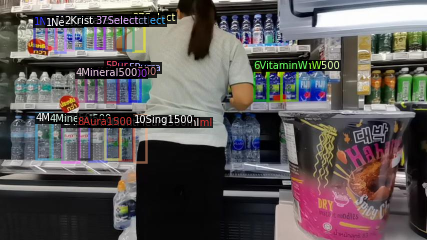

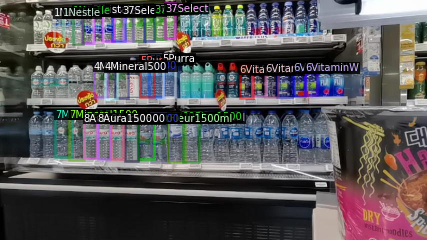

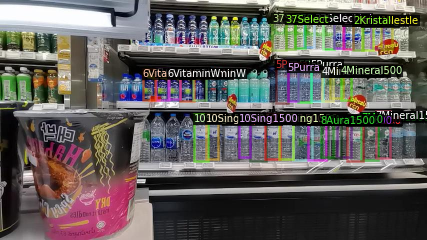

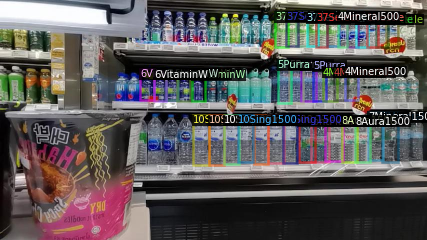

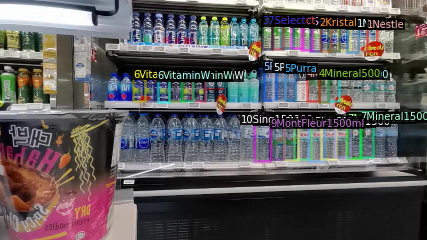

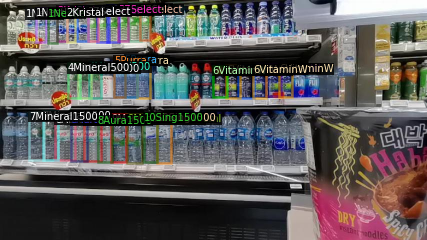

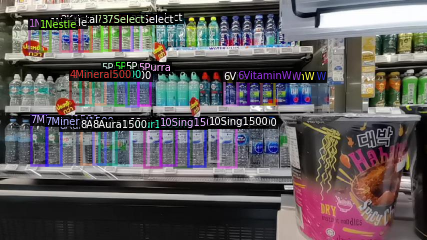

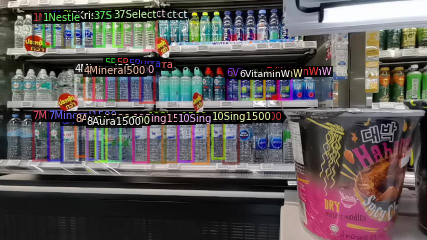

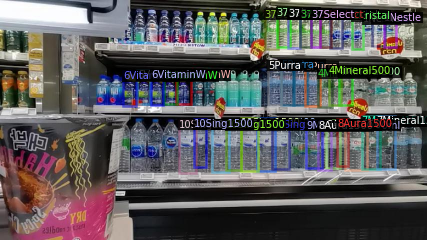

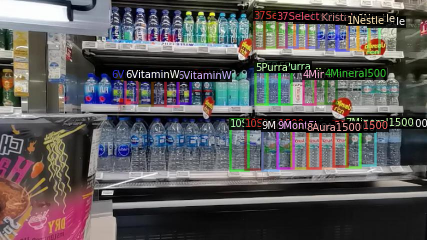

In [6]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 10):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [7]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [8]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")) #Choose model
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 100 #iteration
cfg.SOLVER.MAX_ITER = 300 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (500, 1000)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 10 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/30 03:59:20 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:28, 15.0MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (11, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (11,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (40, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (40,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box

[05/30 03:59:50 d2.engine.train_loop]: Starting training from iteration 0
[05/30 04:00:56 d2.utils.events]:  eta: 0:15:36  iter: 19  total_loss: 3.165  loss_cls: 2.256  loss_box_reg: 0.725  loss_rpn_cls: 0.035  loss_rpn_loc: 0.112  time: 3.3511  data_time: 0.0344  lr: 0.000191  max_mem: 10898M
[05/30 04:02:09 d2.utils.events]:  eta: 0:15:17  iter: 39  total_loss: 1.994  loss_cls: 1.182  loss_box_reg: 0.683  loss_rpn_cls: 0.024  loss_rpn_loc: 0.099  time: 3.4975  data_time: 0.0134  lr: 0.000391  max_mem: 10898M
[05/30 04:03:22 d2.utils.events]:  eta: 0:14:26  iter: 59  total_loss: 1.651  loss_cls: 0.902  loss_box_reg: 0.634  loss_rpn_cls: 0.017  loss_rpn_loc: 0.092  time: 3.5450  data_time: 0.0114  lr: 0.000590  max_mem: 10898M
[05/30 04:04:34 d2.utils.events]:  eta: 0:13:15  iter: 79  total_loss: 1.625  loss_cls: 0.838  loss_box_reg: 0.693  loss_rpn_cls: 0.009  loss_rpn_loc: 0.093  time: 3.5572  data_time: 0.0127  lr: 0.000790  max_mem: 10898M
[05/30 04:05:46 d2.utils.events]:  eta: 0:

In [9]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [19]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [05/30 04:18:27 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/30 04:18:27 d2.data.datasets.coco]: Loaded 20 images in COCO format from /content/test/_annotations.coco.json
[05/30 04:18:27 d2.data.common]: Serializing 20 elements to byte tensors and concatenating them all ...
[05/30 04:18:27 d2.data.common]: Serialized dataset takes 0.03 MiB
[05/30 04:18:27 d2.evaluation.evaluator]: Start inference on 20 images
[05/30 04:18:30 d2.evaluation.evaluator]: Inference done 11/20. 0.3103 s / img. ETA=0:00:02
[05/30 04:18:33 d2.evaluation.evaluator]: Total inference time: 0:00:04.784535 (0.318969 s / img per device, on 1 devices)
[05/30 04:18:33 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:04 (0.310489 s / img per device, on 1 devices)
[05/30 04:18:33 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/30 04:18:33 d2.evaluation.coco_evaluation]: Saving results to ./output/c

OrderedDict([('bbox',
              {'AP': 55.22614692793798,
               'AP--': nan,
               'AP-10Sing1500': 62.09610152133263,
               'AP-1Nestle': 57.51683992675678,
               'AP-2Kristal': 64.50951207152372,
               'AP-37Select': 60.83344299814565,
               'AP-4Mineral500': 58.49835786490427,
               'AP-5Purra': 66.3944091959612,
               'AP-6VitaminW': 59.198429539690935,
               'AP-7Mineral1500': 62.9775830593965,
               'AP-8Aura1500': 60.236793101668226,
               'AP-9MontFleur1500ml': 0.0,
               'AP50': 88.84861907892383,
               'AP75': 68.90414829117859,
               'APl': nan,
               'APm': 56.17322918065041,
               'APs': 23.085808580858085})])

# Inference with Detectron2 Saved Weights



In [20]:
%ls ./output/

coco_instances_results.json                       last_checkpoint
events.out.tfevents.1622347162.064eda8626f5.59.0  metrics.json
instances_predictions.pth                         model_final.pth


In [21]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

## Test Image

Picture: 19 Path: /content/test/Hackathon_data--11--43_jpg.rf.6ff412f54110277ef7afac22ea4bcf04.jpg
10Sing1500:  6
1Nestle:  3
2Kristal:  12
37Select:  9
4Mineral500:  6
5Purra:  0
6VitaminW:  18
7Mineral1500:  6
8Aura1500:  6
9MontFleur1500ml:  0


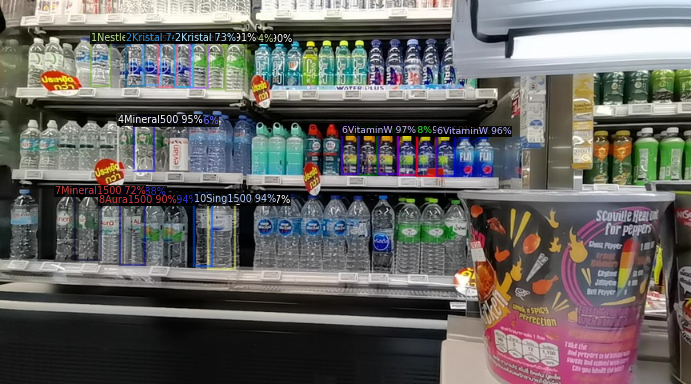

In [106]:
img_path = '/content/TEST050.jpg'

im = cv2.imread(img_path)
outputs = predictor(im)
# print(outputs)
# prediction = outputs['instances']
print('Picture:', i, 'Path:', imageName)
prediction = outputs['instances'].pred_classes.cpu().numpy()
# print(prediction)
prediction_list = prediction.tolist()

counter1 = prediction_list.count(1) * 3
print('10Sing1500: ', counter1)
  

# 1Nestle
counter2 = prediction_list.count(2) * 3
print('1Nestle: ', counter2)

# 2Kristal
counter3 = prediction_list.count(3) * 3
print('2Kristal: ', counter3)

# 37Select 
counter4 = prediction_list.count(4) * 3
print('37Select: ', counter4)

# 4Mineral500
counter5 = prediction_list.count(5) * 3
print('4Mineral500: ', counter5)
  
# 5Purra
counter6 = prediction_list.count(6) * 3
print('5Purra: ', counter6)

# 6VitaminW 
counter7 = prediction_list.count(7) * 3
print('6VitaminW: ', counter7)

# 7Mineral1500
counter8 = prediction_list.count(8) * 3
print('7Mineral1500: ', counter8)

# 8Aura1500:
counter9 = prediction_list.count(9) * 3
print('8Aura1500: ', counter9)

# 9MontFleur1500ml
counter10 = prediction_list.count(10) * 3
print('9MontFleur1500ml: ', counter10)

v = Visualizer(im[:, :, ::-1],
              metadata=test_metadata, 
              scale=0.8)
  
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

with open('/content/data.csv', 'w',newline='\n') as f:
    #  for i, imageName in enumerate(glob.glob('img_path')):
      #  writer.writerow([num]
    data_writer = csv.writer(f, delimiter=',')
    data_writer.writerow([img_path, counter1, counter2, counter3, counter4, counter5, counter6, counter7, counter8, counter9, counter10]) # First Line acts as header

## Test Images in folder

Picture: 0 Path: /content/test/Hackathon_data--11--40_jpg.rf.03ce5975d6f80781b72e86f8fb207586.jpg
10Sing1500:  6
1Nestle:  3
2Kristal:  2
37Select:  7
4Mineral500:  3
5Purra:  4
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  3
9MontFleur1500ml:  0


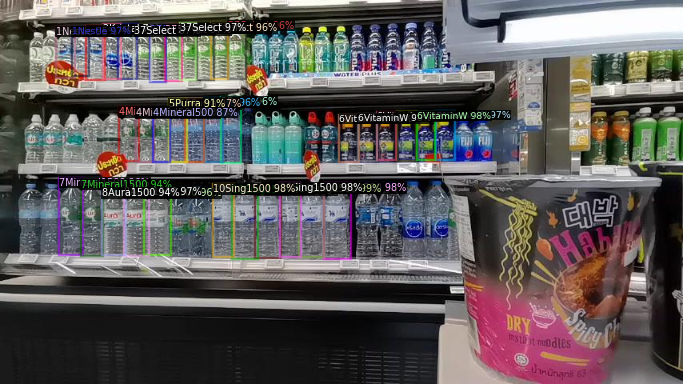



Picture: 1 Path: /content/test/Hackathon_data--11--26_jpg.rf.935b11799daf5c2543eb304c838637af.jpg
10Sing1500:  7
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  4
6VitaminW:  5
7Mineral1500:  2
8Aura1500:  3
9MontFleur1500ml:  0


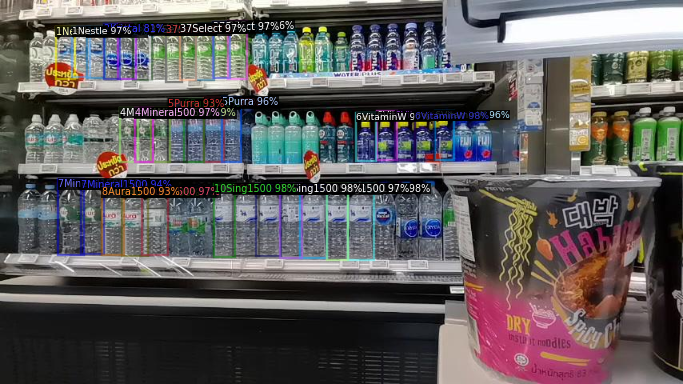



Picture: 2 Path: /content/test/Hackathon_data--1--046_jpg.rf.320f9cf4e9c7383765f7a2437033ddca.jpg
10Sing1500:  2
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  3
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


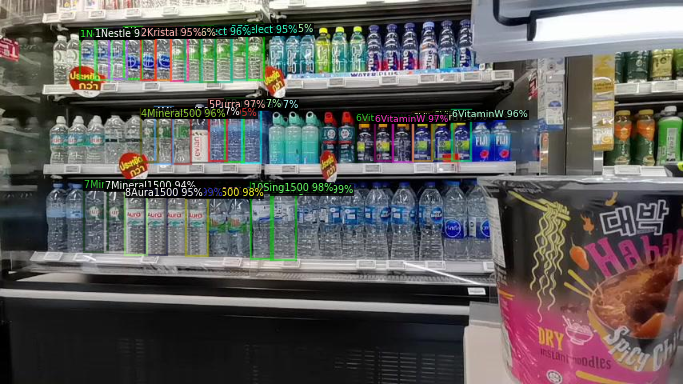



Picture: 3 Path: /content/test/Hackathon_data--11--21_jpg.rf.4dfa7eeacc42d17e67d1ba6cd23e5580.jpg
10Sing1500:  7
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  4
6VitaminW:  5
7Mineral1500:  2
8Aura1500:  3
9MontFleur1500ml:  0


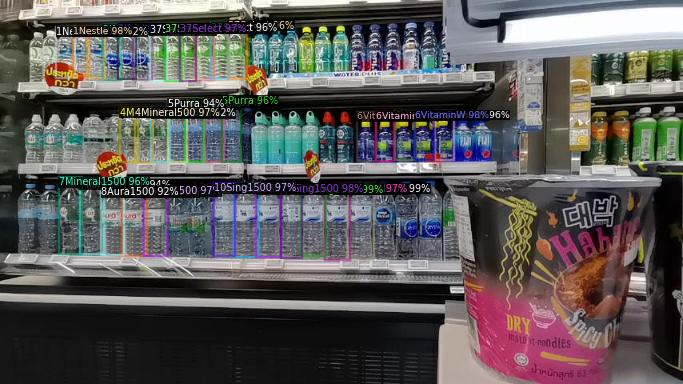



Picture: 4 Path: /content/test/Hackathon_data--1--035_jpg.rf.46ada0d7674e3f2d7dd6cbf1059cf331.jpg
10Sing1500:  2
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  3
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


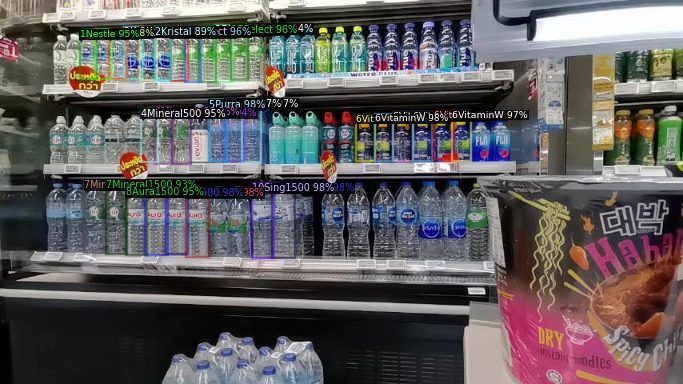



Picture: 5 Path: /content/test/Hackathon_data--1--100_jpg.rf.09a59b3ffbdbceeb919f23a7c670ada1.jpg
10Sing1500:  2
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  3
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


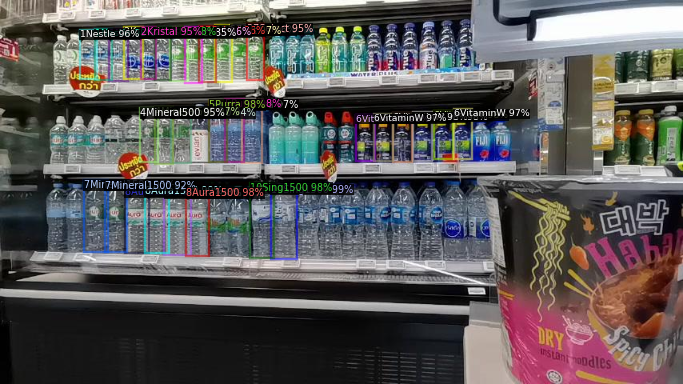



Picture: 6 Path: /content/test/Hackathon_data--1--044_jpg.rf.d3b06ebfa2b1bfa2ba8d4577743cdbe9.jpg
10Sing1500:  2
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  3
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


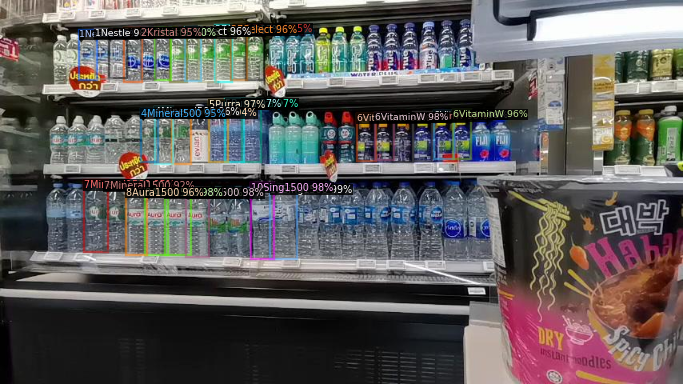



Picture: 7 Path: /content/test/Hackathon_data--11--12_jpg.rf.50b8846dbaf1e180903718fc98600147.jpg
10Sing1500:  7
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  4
6VitaminW:  5
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


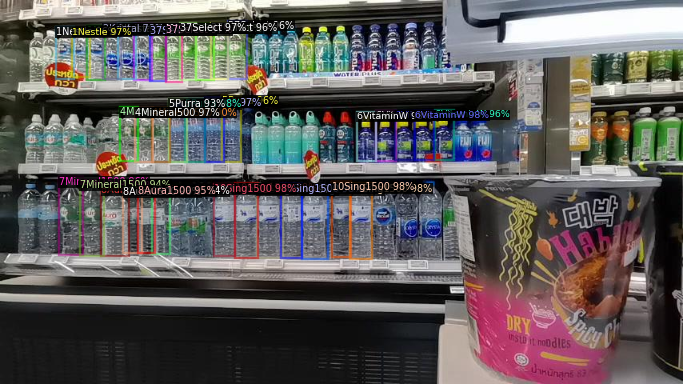



Picture: 8 Path: /content/test/Hackathon_data--1--049_jpg.rf.f222f20ca84d8afc63b3fce92c9dea5d.jpg
10Sing1500:  2
1Nestle:  3
2Kristal:  2
37Select:  6
4Mineral500:  3
5Purra:  3
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


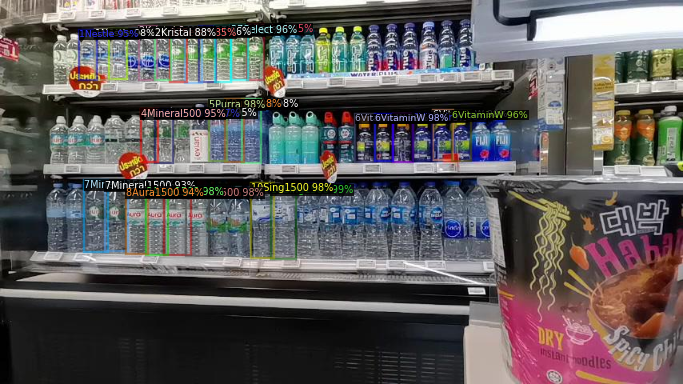



Picture: 9 Path: /content/test/Hackathon_data--1--013_jpg.rf.8dad5604230b2aab1b3f2af34aa87b11.jpg
10Sing1500:  3
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  3
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


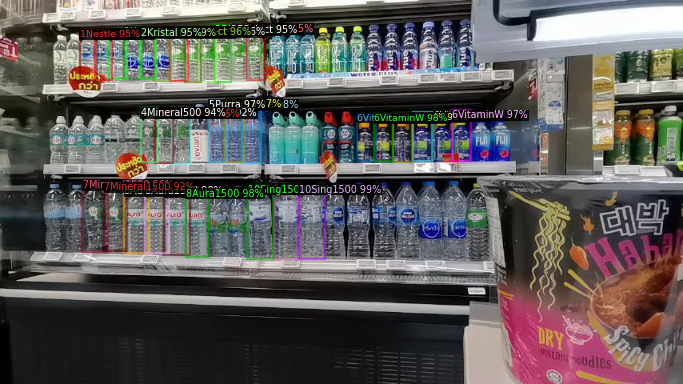



Picture: 10 Path: /content/test/Hackathon_data--1--106_jpg.rf.fe3d1dc71fd3dd9cc07997ef0c39cf16.jpg
10Sing1500:  2
1Nestle:  3
2Kristal:  2
37Select:  6
4Mineral500:  3
5Purra:  3
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


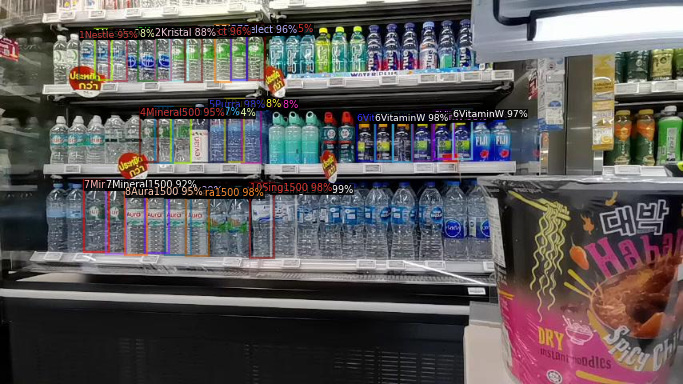



Picture: 11 Path: /content/test/Hackathon_data--11--07_jpg.rf.bf6eace34d5ea782e0b74342494ba872.jpg
10Sing1500:  7
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  4
6VitaminW:  2
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


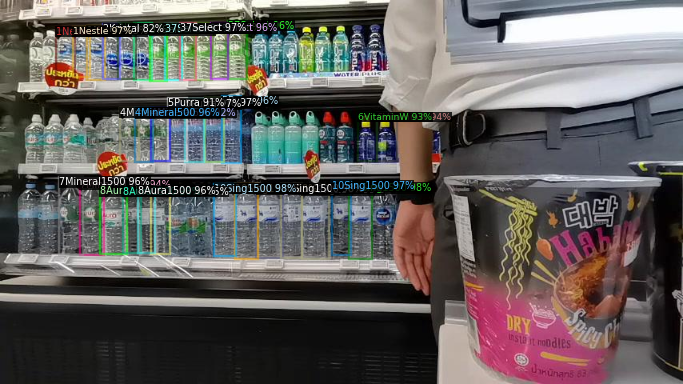



Picture: 12 Path: /content/test/Hackathon_data--1--071_jpg.rf.78d3f3d6ca0c9d2cc3f74ebe6b053870.jpg
10Sing1500:  2
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  3
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


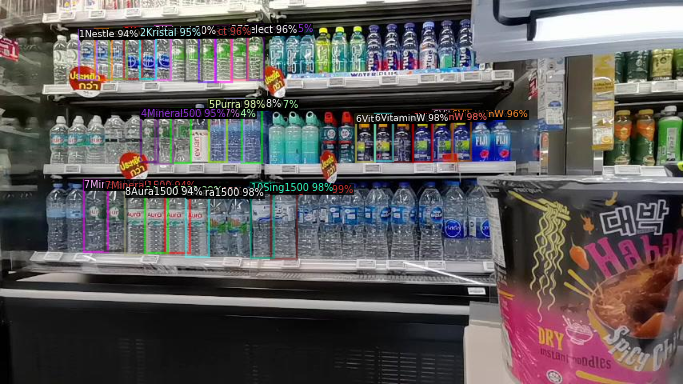



Picture: 13 Path: /content/test/Hackathon_data--11--49_jpg.rf.4b37da5fbb408db163a8118bc8da5435.jpg
10Sing1500:  3
1Nestle:  0
2Kristal:  0
37Select:  7
4Mineral500:  3
5Purra:  3
6VitaminW:  6
7Mineral1500:  1
8Aura1500:  3
9MontFleur1500ml:  0


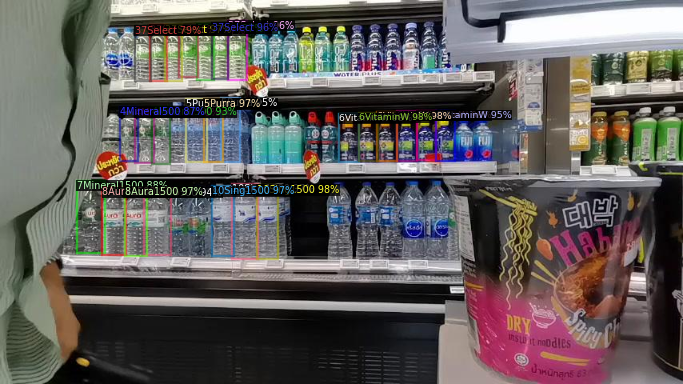



Picture: 14 Path: /content/test/Hackathon_data--11--05_jpg.rf.c033fc1a31d1b1df170f16f2a0c6c45f.jpg
10Sing1500:  7
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  4
6VitaminW:  5
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


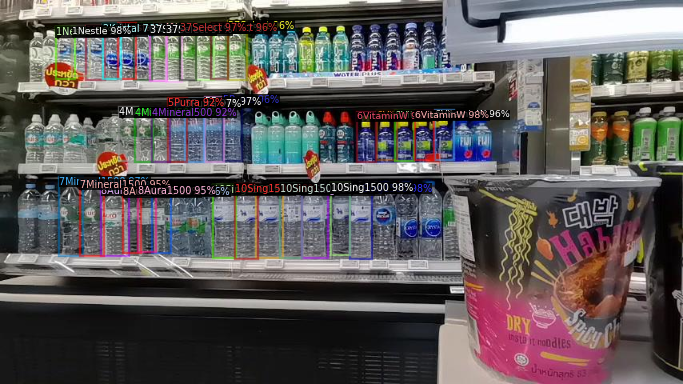



Picture: 15 Path: /content/test/Hackathon_data--11--06_jpg.rf.5073e1d103b759bd4ad1e74a41e61a6d.jpg
10Sing1500:  7
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  4
6VitaminW:  5
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


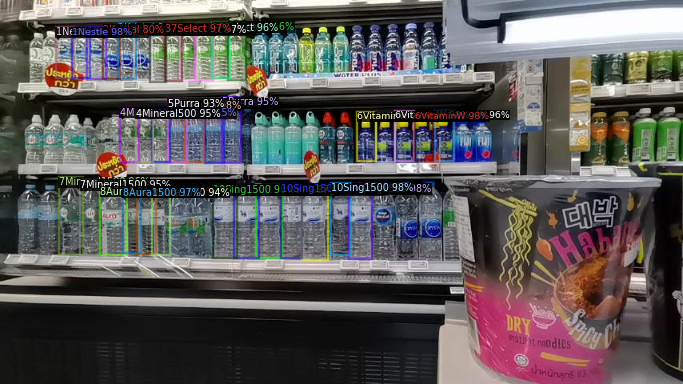



Picture: 16 Path: /content/test/Hackathon_data--1--095_jpg.rf.88b03eb33f4df51e4f3bf5fc6a27d191.jpg
10Sing1500:  2
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  3
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


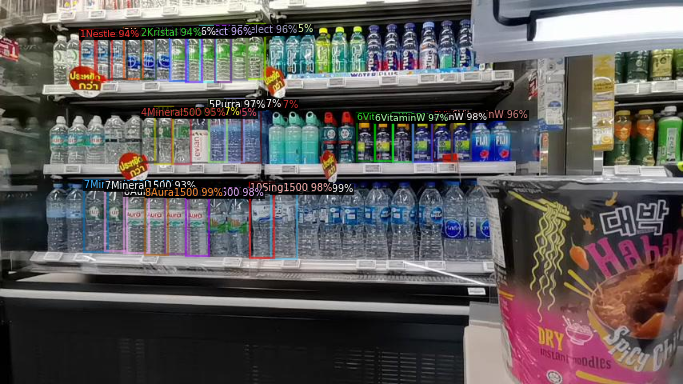



Picture: 17 Path: /content/test/Hackathon_data--11--20_jpg.rf.3a9517605746a267dbff87a1c69359f9.jpg
10Sing1500:  7
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  4
6VitaminW:  5
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


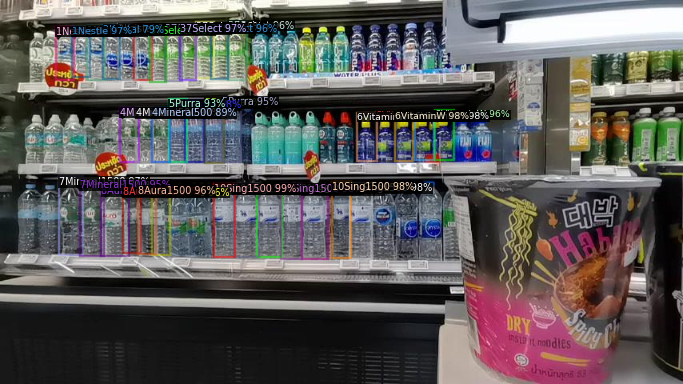



Picture: 18 Path: /content/test/Hackathon_data--1--079_jpg.rf.72846336a4db1fe176450c61f3fe5592.jpg
10Sing1500:  2
1Nestle:  3
2Kristal:  3
37Select:  6
4Mineral500:  3
5Purra:  3
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  4
9MontFleur1500ml:  0


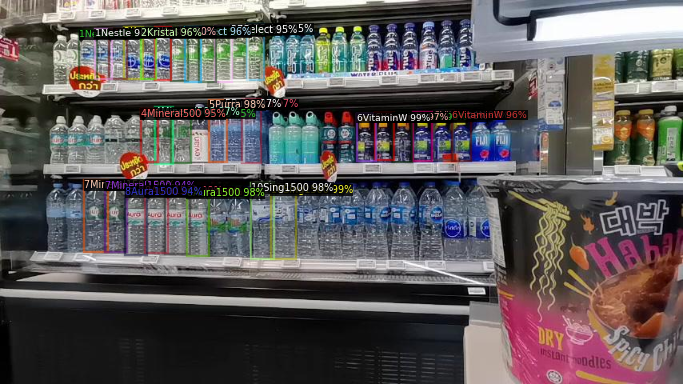



Picture: 19 Path: /content/test/Hackathon_data--11--43_jpg.rf.6ff412f54110277ef7afac22ea4bcf04.jpg
10Sing1500:  6
1Nestle:  3
2Kristal:  2
37Select:  7
4Mineral500:  3
5Purra:  4
6VitaminW:  6
7Mineral1500:  2
8Aura1500:  3
9MontFleur1500ml:  0


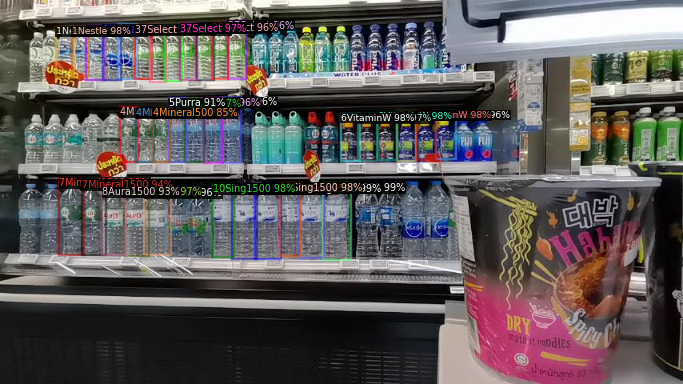

In [48]:
from detectron2.utils.visualizer import ColorMode
import glob

for i, imageName in enumerate(glob.glob('/content/test/*jpg')):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  # print(outputs)
  # prediction = outputs['instances']
  print('Picture:', i, 'Path:', imageName)
  prediction = outputs['instances'].pred_classes.cpu().numpy()
  # print(prediction)
  prediction_list = prediction.tolist()

  list_ = []

  # 10Sing1500  
  counter1 = prediction_list.count(1)
  print('10Sing1500: ', counter1)
  

  # 1Nestle
  counter2 = prediction_list.count(2)
  print('1Nestle: ', counter2)

  # 2Kristal
  counter3 = prediction_list.count(3)
  print('2Kristal: ', counter3)

  # 37Select 
  counter4 = prediction_list.count(4)
  print('37Select: ', counter4)

  # 4Mineral500
  counter5 = prediction_list.count(5)
  print('4Mineral500: ', counter5)
  
  # 5Purra
  counter6 = prediction_list.count(6)
  print('5Purra: ', counter6)

  # 6VitaminW 
  counter7 = prediction_list.count(7)
  print('6VitaminW: ', counter7)

  # 7Mineral1500
  counter8 = prediction_list.count(8)
  print('7Mineral1500: ', counter8)

  # 8Aura1500:
  counter9 = prediction_list.count(9)
  print('8Aura1500: ', counter9)

  # 9MontFleur1500ml
  counter10 = prediction_list.count(10)
  print('9MontFleur1500ml: ', counter10)

  with open('/content/data.csv', 'w',newline='\n') as f:
     for i, imageName in enumerate(glob.glob('/content/test/*jpg')):
      #  writer.writerow([num]
      data_writer = csv.writer(f, delimiter=',')
      data_writer.writerow([i, counter1, counter2, counter3, counter4, counter5, counter6, counter7, counter8, counter9, counter10]) # First Line acts as header


  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8)
  
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
  print('\n')

In [14]:
from google.colab import files
files.download('/content/output/model_final.pth')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Video

In [15]:
# from google.colab import drive
# drive.mount('/content/gdrive')

In [16]:
# from detectron2.utils.video_visualizer import VideoVisualizer
# import tqdm

# # Extract video properties
# video = cv2.VideoCapture('/content/gdrive/MyDrive/True Lab Start-Up Sandbox/Beagle - Dog Breed Information.mp4')
# width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
# height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
# frames_per_second = video.get(cv2.CAP_PROP_FPS)
# num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

# # Initialize visualizer
# v = VideoVisualizer(MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), ColorMode.IMAGE)


# # Initialize video writer
# video_writer = cv2.VideoWriter('detection_output_vdo.mp4', fourcc=cv2.VideoWriter_fourcc(*"mp4v"), fps=float(frames_per_second), frameSize=(width, height), isColor=True)


# def runOnVideo(video, maxFrames):
#     """ Runs the predictor on every frame in the video (unless maxFrames is given),
#     and returns the frame with the predictions drawn.
#     """

#     readFrames = 0
#     while True:
#         hasFrame, frame = video.read()
#         if not hasFrame:
#             break

#         # Get prediction results for this frame
#         outputs = predictor(frame)

#         # Make sure the frame is colored
#         frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)

#         # Draw a visualization of the predictions using the video visualizer
#         visualization = v.draw_instance_predictions(frame, outputs["instances"].to("cpu"))

#         # Convert Matplotlib RGB format to OpenCV BGR format
#         visualization = cv2.cvtColor(visualization.get_image(), cv2.COLOR_RGB2BGR)

#         yield visualization

#         readFrames += 1
#         if readFrames > maxFrames:
#             break

# # Create a cut-off for debugging
# num_frames = 500

# # Enumerate the frames of the video
# for visualization in tqdm.tqdm(runOnVideo(video, num_frames), total=num_frames):

#     # Write test image
#     cv2.imwrite('POSE_detectron.png', visualization)

#     # Write to video file
#     video_writer.write(visualization)

# # Release resources
# video.release()
# video_writer.release()
# cv2.destroyAllWindows()

In [17]:
# from google.colab import files
# files.download('/content/detection_output_vdo.mp4')